In [1]:
!pip install tweepy
!pip install vaderSentiment

In [1]:
import tweepy
import pandas as pd
from nltk.sentiment.vader import SentimentIntensityAnalyzer
import re

In [11]:
#My Twitter API Authentication Variables
consumer_key = '4QkEAd9TGIcTWBpTXKjx1qdxx'
consumer_secret = 'PXnJTltJ9lY2i1iIqdjXqtSRQHW2edDqq5hSdUWLQ3libcKilW'

In [13]:
auth = tweepy.OAuthHandler(consumer_key, consumer_secret)

api = tweepy.API(auth)

#query used for search results
search_query = 'realDonaldTrump'

#query used for getting tweets from a specefic users timeline
screen_name = 'realDonaldTrump'

#search tweets
tweets = api.search(search_query, count=100, lang = 'en', result_type = 'recent')

#timeline tweets
timeline_tweets = api.user_timeline(screen_name, count = 199)

#search data
data = pd.DataFrame(data=[tweet.text for tweet in tweets], columns=['Tweets'])

#timeline data 
data_user = pd.DataFrame(data=[tweet.text for tweet in timeline_tweets], columns=['Tweets'])

#print("Search Result Data")
#display(data.head(10))

print("User Timeline Data")
display(data_user.head(10))


print(tweets[0].created_at)

User Timeline Data


,Tweets
0,Only a few people showed up for the so-called ...
1,Wow! The State Department said it has identif...
2,The story in the @nytimes about the U.S. escal...
3,Thousands of people are already lined up in Or...
4,....long before they get to our Southern Borde...
5,Next week ICE will begin the process of removi...
6,.@FoxNews Polls are always bad for me. They we...
7,One size doesn’t fit all - I support West Virg...
8,“Iran to defy Uranium Stockpile Limits”
9,Only Fake Polls show us behind the Motley Crew...


2019-06-18 08:48:30


In [306]:
import nltk
nltk.download('vader_lexicon')

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\sk8er\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


True

In [14]:
#SID object for getting polarity scores from search results 
sid = SentimentIntensityAnalyzer()
#SID object for getting polarity scores from specified users timeline 
sid_user = SentimentIntensityAnalyzer()

#python list for search results
listy = []

listy_user = []

#populate python list with polarity scores for search results
for index, row in data.iterrows():
  ss = sid.polarity_scores(row["Tweets"])
  listy.append(ss)

#populate python list with polarity scores for user timeline    
for index, row in data_user.iterrows():
  ss1 = sid_user.polarity_scores(row["Tweets"])
  listy_user.append(ss1)

#create pandas Series object for search results 
se = pd.Series(listy)

#create pandas Series objet for specified user timeline 
sc = pd.Series(listy_user)

#create second column of polarity scores in each dataset
data['polarity'] = se.values
data_user['polarity'] = sc.values

#display(data.head(100))
display(data_user.head(100))
print(tweets[0].created_at)


,Tweets,polarity
0,Only a few people showed up for the so-called ...,"{'neg': 0.104, 'neu': 0.896, 'pos': 0.0, 'comp..."
1,Wow! The State Department said it has identif...,"{'neg': 0.0, 'neu': 0.724, 'pos': 0.276, 'comp..."
2,The story in the @nytimes about the U.S. escal...,"{'neg': 0.329, 'neu': 0.671, 'pos': 0.0, 'comp..."
3,Thousands of people are already lined up in Or...,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound..."
4,....long before they get to our Southern Borde...,"{'neg': 0.0, 'neu': 0.749, 'pos': 0.251, 'comp..."
5,Next week ICE will begin the process of removi...,"{'neg': 0.153, 'neu': 0.847, 'pos': 0.0, 'comp..."
6,.@FoxNews Polls are always bad for me. They we...,"{'neg': 0.215, 'neu': 0.785, 'pos': 0.0, 'comp..."
7,One size doesn’t fit all - I support West Virg...,"{'neg': 0.0, 'neu': 0.557, 'pos': 0.443, 'comp..."
8,“Iran to defy Uranium Stockpile Limits”,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound..."
9,Only Fake Polls show us behind the Motley Crew...,"{'neg': 0.069, 'neu': 0.745, 'pos': 0.186, 'co..."


2019-06-18 08:48:30


# The Compound score 
is a metric that calculates the sum of all the lexicon ratings which have been normalized between -1(most extreme negative) and +1 (most extreme positive). In the case above, lexicon ratings for andsupercool are 2.9and respectively1.3. The compound score turns out to be 0.75 , denoting a very high positive sentiment.


In [15]:
def compoundScoreIsolateSearch(data):
    #create an empty list. This will be used as a sublist of all the compound values in our list of tweets. 
    compoundListValuesSearch = []
    
    #iterate through the entire list appending 'compound' key values
    for i in range(len(listy)):
        for key in listy[i]:
            compoundListValuesSearch.append(listy[i]['compound'])
            
    return compoundListValuesSearch

def compoundScoreIsolateUser(data):
    #create an empty list. This will be used as a sublist of all the compound values in our list of tweets. 
    compoundListValuesUser = [] 
    
    #iterate through the entire list appending 'compound' key values
    for i in range(len(listy_user)):
        for key in listy_user[i]:
            compoundListValuesUser.append(listy_user[i]['compound'])
            
    return compoundListValuesUser

import statistics 
#calculate the mean of the dataset
compoundScoreMean = statistics.mean(compoundScoreIsolateUser(listy_user)) 
print('Mean of the dataset', compoundScoreMean)

Mean of the dataset 0.11460452261306532


In [16]:
''' 
helper function. Takes in api results(tweets/timeline_tweets)
'''
def created_at(tweets):
    print('Newest Tweet in Data Created At: ', tweets[0].created_at)
    print('Oldest Tweet in Data Created At', tweets[-1].created_at)


Newest Tweet in Data Created At:  2019-06-18 05:10:06
Oldest Tweet in Data Created At 2019-06-08 00:31:07
The Mean Compound Sentiment For realDonaldTrump: 0.11
Slightly Positive Sentiment


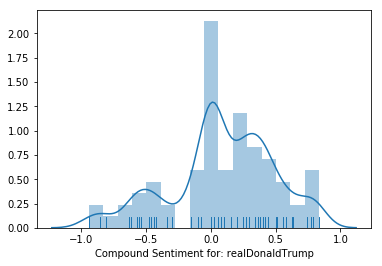

In [17]:
import seaborn as sns
import numpy as np
#create an empty list. This will be used as a sublist of all the compound values in our list of tweets. 
compoundListValues = []

#iterate through the entire list appending 'compound' key values
for i in range(len(listy)):
    for key in listy[i]:
        compoundListValues.append(listy[i]['compound'])

labeled_dist = pd.Series(compoundListValues, name = 'Compound Sentiment for: ' + screen_name)
compoundListValues = np.array(compoundListValues)
sns.distplot(labeled_dist, rug = True, norm_hist = True)
created_at(timeline_tweets)

print('The Mean Compound Sentiment For ' + screen_name + ':' , "{0:.2f}".format(compoundScoreMean))

if compoundScoreMean < 0:
    print("slightly Negative sentiment")
if compoundScoreMean < -.25:
    print("Somewhat Negative Sentiment") 
if  compoundScoreMean < -.50:
    print("Negative Sentiment")
if compoundScoreMean < -.75:
    print("Very Negative Sentiment")
if compoundScoreMean > 0:
    print("Slightly Positive Sentiment")
if compoundScoreMean > 0.25: 
    print("Somewhat Positive Sentiment")
if compoundScoreMean > .5:
    print("Positive Sentiments")
if compoundScoreMean > .75:
    print("Highly Positive Sentiment")


In [10]:
from PIL import Image
from wordcloud import WordCloud, STOPWORDS
from IPython.display import Image as im
import matplotlib.pyplot as plt

#Extract textfields from tweets
raw_tweets = []


timeline_tweets
for tweets in timeline_tweets:
    raw_tweets.append(tweets.text)
    
#Create a string form of our list of text
raw_string = ''.join(raw_tweets)
no_links = re.sub(r'http\S+', '', raw_string)
no_unicode = re.sub(r"\\[a-z][a-z]?[0-9]+", '', no_links)
no_special_characters = re.sub('[^A-Za-z ]+', '', no_unicode)

words = no_special_characters.split(" ")
words = [w for w in words if len(w) > 2]  # ignore a, an, be, ...
words = [w.lower() for w in words]
words = [w for w in words if w not in STOPWORDS]

mask = np.array(Image.open('/Users/sk8er/Desktop/stencil/trump.png'))

wc = WordCloud(background_color="white", max_words=2000, mask=mask)
clean_string = ','.join(words)
wc.generate(clean_string)

f = plt.figure(figsize=(300,300))
f.add_subplot(1,2, 1)
plt.imshow(mask, cmap=plt.cm.gray, interpolation='bilinear')
plt.title('Original Stencil', size=400, color = 'red')
plt.axis("off")
f.add_subplot(1,2, 2)
plt.imshow(wc, interpolation='bilinear')
plt.title('Generated Cloud For Twitter User @' + screen_name , size=400, color = 'red')
plt.axis("off")
plt.show()